In [9]:
# hide annoying jupyter warning on every cell in current conda-installed version
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:
from osgeo import gdal, ogr
import numpy as np
import tensorflow as tf
import glob
import datetime
import os
import sys
from datetime import datetime, date

In [3]:
import descarteslabs as dl
import matplotlib.pyplot as plt

In [10]:
import training_data_utils; from training_data_utils import gdal_dataset_from_geocontext, create_chips_for_tile, TileJobConfig
import tf_example_creation; from tf_example_creation import convert_to_example


In [11]:
import geopandas as gpd

class SampleCreationConfig:
    """Holds the parameters needed to configure an extraction of image chips from the 
    Descartes Labs (DL) API
    
    Image chip locations, extent, and naming are based on the DL tiling scheme. An 
    instance of this class is configured with the desired image chip size, padding, 
    and resolution, and an OGR-compatible spatial dataset giving the area to be 
    covered. The necessary DLTiles to cover this area will be calculated and then 
    these, along with the other necessary parameters such as product ID, bands, and 
    output folder can be used to create TileJobConfig objects for each tile that 
    needs exporting.
    """
    
    def __init__(self,  tile_size, tile_padding, tile_res_m, 
                 dl_product, bands, 
                 sample_folder_root, source_tag,
                 label_data_config,
                max_cloud_fraction=None):
        """Params:
        tile_size: The size of the (square) tiles in pixels, INCLUDING padding.
            i.e. each tile will have tile_size - (2*tile_padding) pixels that are 
            unique to it and not shared with adjacent ones, in each dimension
        tile_padding: The number of pixels of padding (overlap) between the tiles. 
        tile_res_m: The pixel resolution in metres that images will be created at.
            The spatial extent of each tile is thus tile_size * tile_res_m.
        dl_product: The Descartes Labs product ID (search in catalog.descarteslabs.com)
        bands: A space-separatd string giving the band names to export e.g. "red green blue" 
            Check the available names in the DL catalog
        sample_folder_root: The folder below which to create a folder for this export session.
        source_tag: A tag to identify this export in exported folder and file names 
            E.g. "sentinel"
        label_data_config: An OGRLabelDataDesc object which specifies the vector dataset 
            to rasterise to make the labels data corresponding to the imagery data
        max_cloud_fraction: A decimal value between 0 and 1 specifying the maximum allowable 
            cloud fraction in images selected for mosaicking - where supported (e.g. works 
            with Sentinel-2 data but not with Pleiades). If None then no cloud filtering will 
            be done.
        """
        # readonly items, if these change then we need to recalculate tiles so handle 
        # via getter/setter or totally readonly
        self._TILE_SIZE = tile_size - 2 * tile_padding
        self._TILE_PAD = tile_padding
        self._TILE_RES = tile_res_m
        self._LABEL_DATA = label_data_config 
        # no sense in being alterable
        self._root = sample_folder_root
        self._tag = source_tag
        
        self._PRODUCT = dl_product
        self._BANDS = bands
        self._MAX_CLOUD_FRACTION = max_cloud_fraction
        # expensive-to-create things that we'll cache
        self._dl_tiles = None
        self._dl_tile_ids = None
        self._gdf_wgs84 = None

        
    def TILE_SIZE_PAD_RES(self, size_pad_res=None):
        if size_pad_res is None:
            return (self._TILE_SIZE, self._TILE_PAD, self._TILE_RES)
        s, p, r = size_pad_res
        s = s  - (2 * p)
        if s != self._TILE_SIZE or p != self._TILE_PAD or r != self._TILE_RES:
            print("Updating tile  configuration: tiles will be re-populated on next request")
            self._TILE_SIZE = s
            self._TILE_PAD = p
            self._TILE_RES = r
            self._invalidate_tiles()
        return (self._TILE_SIZE, self._TILE_PAD, self._TILE_RES)
        

    def LABEL_DATA(self):
        return self._LABEL_DATA # readonly
    
    
    def PRODUCT(self):
        return self._PRODUCT
    
    
    def BANDS(self):
        return self._BANDS
    
    
    def GET_MAX_CLOUD_FRACTION(self):
        return self._MAX_CLOUD_FRACTION
    
    
    def SET_MAX_CLOUD_FRACTION(self, new_cf):
        self._MAX_CLOUD_FRACTION = new_cf
        
    
    def _invalidate_tiles(self):
        self._dl_tiles = None
        self._dl_tile_ids = None
    
    
    def _tag_with_cf(self):
        if self._MAX_CLOUD_FRACTION is None:
            return self._tag
        return f"{self._tag}-cf{str(self._MAX_CLOUD_FRACTION).replace('.','p')}"
    
    
    def _total_tile_size(self):
        return self._TILE_SIZE + (2 * self._TILE_PAD)
    
    
    def images_dir_name(self, loc, year):
        """Suggest the name of the subfolder for this export session based on the configured and passed variables:
            
            `tag-cloudfraction_resolution_padding_tilesize_loc_year`
            
            Images and labels will then go into images/ and labels/ subfolders of this."""
        return os.path.join(self._root,
                            f"{self._tag_with_cf()}_{self._TILE_RES}m_{self._TILE_PAD}pad_{self._total_tile_size()}_{loc}_{year}")
    
    
    def dataset_name(self, loc, year, tfrecord_type="arr"):
        """Suggest the name of the tfrecords dataset to be created from this export session:
        
        `tag-cloudfraction_tfrecordtype_loc_year"""
        return f"{self._tag_with_cf()}_{tfrecord_type}_{loc}_{year}"        
        
    
    def get_tiles(self):
        """Find DLTiles of the configured size/resolution that intersect the features in the 
        configured labels dataset. Will be populated on first call or after updating tile size 
        details - this can take a minute or two."""
        if self._dl_tiles is None:
            self._populate_DLTiles()
        return self._dl_tiles
    
    
    def get_tile_ids(self):
        """Find DLTiles of the configured size/resolution that intersect the features in the 
        configured labels dataset, and return their IDs (keys). 
        Will be populated on first call or after updating tile size details - this can take
        a minute or two."""
        if self._dl_tile_ids is None:
            self._populate_DLTiles()
        return self._dl_tile_ids
    
    
    def get_labeldata_wgs84_df(self):
        if self._gdf_wgs84 is not None:
            return self._gdf_wgs84
        gdf_labels = gpd.read_file(self._LABEL_DATA.OGR_DATASET, 
        layer = self._LABEL_DATA.get_layer_index())
        # our labels data are in UTM (or could be anything else) but DLTile.from_shape needs WGS84
        self._gdf_wgs84 = gdf_labels.to_crs('EPSG:4326')
        return self._gdf_wgs84
        
        
    def create_tile_job_configs(self, loc_label, year_label, 
                                ref_date, min_date=None, max_date=None):
        
        tile_export_jobs = [TileJobConfig.from_run_config(self, 
                                    dltile=t,
                                    out_folder_base=self.images_dir_name(loc_label, year_label),
                                    ref_date=ref_date,
                                    min_date=min_date,
                                    max_date=max_date,
                                    max_cloud_fraction=self._MAX_CLOUD_FRACTION
                                    ) for t in self.get_tiles()]
        return tile_export_jobs
        
        
    def _populate_DLTiles(self):
        
        gdf_wgs84 = self.get_labeldata_wgs84_df()
        
        # We need to get all DLTiles of the specified size and resolution that intersect the extent polygons.
        # We'll dissolve them first, and split back by parts. This will reduce the complexity of the geometries 
        # because all our the slum polygons sit within the non-slum ones and so can be merged into them for 
        # the purposes of finding intersecting tiles. This will help discourage DLTile.from_shape from breaking, 
        # which it likes to do sometimes.
        dissolved = gpd.geoseries.GeoSeries([geom for geom in gdf_wgs84.unary_union.geoms])
        
        # We'll then find all the intersecting tiles for each remaining geometry by iterating through one at a time. 
            # i.e. a panda-ised version of this
            #all_tiles = []
            #for _,f in gdf_wgs84.iterrows():
            #    these_tiles = dl.scenes.DLTile.from_shape(f['geometry'], TILE_RES, TILE_SIZE, TILE_PAD)
            #    print(str(len(these_tiles))+', ',end='')

            #    all_tiles.extend(these_tiles)
        # TODO use pandarallel or something to speed this up
        tiles = dissolved.apply(dl.scenes.DLTile.from_shape, args=(
            self._TILE_RES, 
            self._TILE_SIZE, 
            self._TILE_PAD
        ))  
        
        # Each row is now a list of tiles that intersected that polygon. Flatten back to a single list.
        all_tiles = [ x for i, y in tiles.apply(list).iteritems() for x in y]
        
        # Because multiple input polygons may intersect the same DLTile, there are likely to be duplicates 
        # as we have searched for covering tiles separately for each polygon each turn. The easiest way to 
        # avoid this happening would probably be to concatenate all shapes in to a single multipolygon and 
        # make a single call to DLTile.from_shape, but that's not very flexible, would be slow,  and there 
        # seems to be some limit on the complexity of geometry that DLTile.from_shape can cope with.

        # Instead, get a unique set of the tiles.
        # DLTile is not hashable so we can't just do set(all_tiles), instead we will use the string keys of 
        # the tiles as a comparator. That would suggest this approach to creating the unique list of tiles:

        # all_tile_ids = [t.key for t in all_tiles]
        # unique_tile_ids = set(all_tile_ids)
        # unique_tiles = [dl.scenes.DLTile.from_key(k) for k in unique_tile_ids]
                
        # However, DON'T do this: it's VERY slow. I think that creating a DLTile.from_key must be server-side 
        # so there are lots of round trips. Instead we'll compare the existing tile objects on their key and 
        # use it to build the list of unique tiles. 
        # This is the Decorate-Sort-Undecorate pattern, i.e. roll-your-own Set.
        unique_tile_ids = set()
        unique_tiles = []
        for tile in all_tiles:
            k = tile.key
            if k not in unique_tile_ids:
                unique_tile_ids.add(k)
                unique_tiles.append(tile)
                
        self._dl_tiles = unique_tiles
        self._dl_tile_ids = unique_tile_ids
                
            
            
class OGRLabelDataDesc:
    
    def __init__(self, ogr_dataset, ogr_layer_name_or_idx=0, attrib_to_burn=None):
        """Params:
        ogr_dataset: the path to an OGR-supported dataset e.g. shapefile, GeoJSON file, or file geodatabase directory
        ogr_layer_name_or_idx: the layername OR index of the layer within the dataset. For any data type that only 
            contains one layer (e.g. GeoJSON or shapefile), use 0 (or the filename without extension). Otherwise 
            use the name (=feature class name) to save having to find the index
        attrib_to_burn: an integer-type feature attribute giving the values to burn to the label images. If None, 
            then all features will be burned with a constant value of 1
        """
        self.OGR_DATASET = ogr_dataset
        self.OGR_LAYER_REF = ogr_layer_name_or_idx
        self.BURN_ATTRIB = attrib_to_burn
        self._cached_layer_idx = None

    def get_layer_index(self):
        if isinstance(self.OGR_LAYER_REF, int):
            return self.OGR_LAYER_REF
        else:
            if self._cached_layer_idx is not None:
                return self._cached_layer_idx
            layernames = []
            label_ogr_ds = ogr.Open(self.OGR_DATASET)
            for layer_idx in range(label_ogr_ds.GetLayerCount()):
                lyr = label_ogr_ds.GetLayerByIndex(layer_idx)
                layernames.append(lyr.GetName()) 
            label_ogr_ds = None
            if self.OGR_LAYER_REF in layernames:
                self._cached_layer_idx = layernames.index(self.OGR_LAYER_REF)
            else:
                self._cached_layer_idx = -1
            return self._cached_layer_idx
        label_lyr = label_ogr_ds.GetLayerByIndex(label_lyr_idx)

## Loading the labels data

The DL Wellpads sample used GeoJSON and parsed it directly, and didn't use a classification attribute in the data (any polygon present was deemed to be wellpad (slum)).

Now we'll switch to using OGR to import any other suitable geographic data type. I'm using an ESRI file geodatabase but shapefiles (or indeed GeoJSON) will work equally well. Create a simple config object to hold the three parameters necessary to describe which data to use._MAX_CLOUD_FRACTION

In [12]:
_gdb = r'C:\Users\harry\OneDrive - Nexus365\Informal_Cities\ML_Slum_Prediction\Ground_Truthing_Data\Gram-Hansen_Training_Data\Gram-Hansen_Training_Data.gdb'

mumbai_labels_data = OGRLabelDataDesc(
    ogr_dataset=_gdb,
    ogr_layer_name_or_idx="Mumbai_Labels_Final",
    attrib_to_burn="gridcode"
)

nairobi_labels_data = OGRLabelDataDesc(
    ogr_dataset=_gdb,
    ogr_layer_name_or_idx="nairobi_ground_truth",
    attrib_to_burn="gridcode"
)


In [13]:
IMAGE_CHIPS_ROOT = "C:/Users/harry/Documents/Data/"

IC_VHR_SAMPLE_CONFIG = SampleCreationConfig(**{
    "tile_size": 256,
    "tile_padding": 2,
    "tile_res_m": 1,
    "dl_product": "airbus:oneatlas:phr:v2",
    "bands": "red green blue",
    "sample_folder_root": IMAGE_CHIPS_ROOT,
    "source_tag": "airbus",
    "label_data_config": mumbai_labels_data
})

IC_LR_SAMPLE_CONFIG = SampleCreationConfig(
    tile_size=64, 
    tile_padding=2, 
    tile_res_m=10,
    dl_product="sentinel-2:L1C",
    bands="coastal-aerosol blue green red red-edge red-edge-2 red-edge-3 nir red-edge-4 water-vapor cirrus swir1 swir2",
    sample_folder_root=IMAGE_CHIPS_ROOT,
    source_tag="sentinel",
    label_data_config=mumbai_labels_data
)

IC_LR_RGB_CONFIG = SampleCreationConfig(
    tile_size=64, 
    tile_padding=2, 
    tile_res_m=10,
    dl_product="sentinel-2:L1C",
    bands="red green blue",
    sample_folder_root=IMAGE_CHIPS_ROOT,
    source_tag="sentinel-rgb",
    label_data_config=mumbai_labels_data
)


# Configure this run


In [49]:
THIS_RUN_CONFIG = IC_VHR_SAMPLE_CONFIG # IC_LR_SAMPLE_CONFIG


In [50]:
THIS_RUN_CONFIG.TILE_SIZE_PAD_RES()

(252, 2, 1)

In [24]:
THIS_RUN_CONFIG.TILE_SIZE_PAD_RES((256,2,1))

(252, 2, 1)

# Define training sample locations

To generate training samples (image tiles or chips) we will use DLTiles to define the extent of each tile. This is a Descartes-Labs specific concept which provides a uniquely-identified scheme of tiles to cover any area with tiles of any specified size. 

To identify the areas within which we need to export the DLTile-bounded images, we need polygons defining both the slum areas and some known non-slum areas, to ensure that both are represented in the training data, and in particular a range of different alternative land covers in non-slum areas (not just built-up but also green space, water, etc). 

Unlike in the wellpads sample, we don't want to **only** cover the slum polygons, as we expect that in this case we will not capture a sufficient variety of non-slum areas for the model to be trained to recognise them; the only non-slum the model would then see would be the bits that happened to be within one tile's width of the edge of a slum. 

But at the same time we don't want to cover the entirety of the city with training samples (e.g. the bounding box of the slum areas). In this case the training data would probably be strongly biased towards non-slum, which may not be a good thing(?) , and in any case this would probably be an unfeasibly large area to cover.

We will identify all tiles which intersect either type of polygon.

### Choosing non-slum areas: Mumbai 

For the Mumbai data, we have a set of slum polygons georeferenced and digitised from the PKDas associates slum map. These are deemed as complete, for our entire area of interest - i.e. anything that is not labelled as slum can be considered to really not be slum. 

So to make a set of non-slum polygons, we can automate it a bit. 

- Firstly I created and dissolved a buffer around the slum polygons of 250m - this value was somewhat empirical, with the logic that it would cover ~2 full sample tiles around every slum (at 0.5m resolution and 256pixel tiles). 
- Secondly I created a number of random point locations within the "universe" of analysis (for this I used the admin-1 boundaries of the city (Mumbai) and created 1000 points within these boundaries). 
- Next I discarded the random points that were already within the slum buffer. For the remainder, I buffered them by 250m too. These combined buffers give our extent polygons.
- To create the final label dataset we then erase the slum polygons from the extent polygons, and merge the result back with the slum polygons.

### Choosing non-slum areas: Nairobi / Elsewhere

In other areas we have some slum polygons (from the Gram-Hansen paper, etc) but we cannot be sure that these represent all the slum within the city. Therefore we can't blindly create label data saying "non-slum" for areas outside the polygons, as we may well capture areas that are really slum but weren't in our input dataset. 

So we have to make our extent polygons through manual inspection to ensure we don't encompass any areas which look like slum but aren't flagged as such. Therefore we've used a GIS to digitise them by hand, with reference to imagery data. We've placed these polygons around mapped slum areas, ensuring that nothing else that looked like slum was not labelled, and that we captured a range of different land covers.

### Get a suitable representation of the features

The Descartes Labs DLTile.from_shape can use a GeoJSON feature directly, or anything that has a __geo_interface__ . This means we can use geopandas to read any OGR supported dataset and then expose the __geo_interface__ i.e. a GeoJSON representation of it. The bonus of doing this is that geopandas can reproject it to WGS84 first, which is required by the Descartes method.

In [123]:
unique_tiles = THIS_RUN_CONFIG.get_tiles()

In [124]:
len(unique_tiles)

5976

In [125]:
unique_tile_ids = THIS_RUN_CONFIG.get_tile_ids()

In [126]:
len(unique_tile_ids)

5976

In [127]:
THIS_RUN_CONFIG.TILE_SIZE_PAD_RES()

(252, 2, 1)

#### Visualise the geometries

Let's plot the various polygons on a map so we can see what's up

First create a geopandas dataframe of the tile keys and geometries, which is a format that we can map easily

In [128]:
tile_geoms = gpd.GeoDataFrame([(t.key, t.geometry) for t in unique_tiles], 
                              columns=['tile_key', 'geometry'])
tile_geoms.crs = 'EPSG:4326'

In [22]:
# if we need to store the tile geometries back to a GIS dataset for any reason:
#tile_geoms.to_file(r'C:/Users/harry/Documents/Data/sentinel_mumbai_tiles.shp')

Do the same for the labels (ground truth) file (re-read it). Throw away the non-slum features, we just want to visualise the slums for the moment.

In [129]:
label_geoms = gpd.read_file(THIS_RUN_CONFIG.LABEL_DATA().OGR_DATASET, 
                           layer=THIS_RUN_CONFIG.LABEL_DATA().get_layer_index())
label_geoms = label_geoms.drop(label_geoms[label_geoms[THIS_RUN_CONFIG.LABEL_DATA().BURN_ATTRIB]==0].index)

Now add each to an interactive folium map with different colours

In [130]:
import folium

In [131]:
_w, _s, _e, _n = tile_geoms.total_bounds
centre_lat_lon = ((_s+_n)/2, (_w+_e)/2)
m = folium.Map(location=centre_lat_lon, zoom_start=11)

In [132]:
tstyle= {'fillColor': '#0055FFFF', 'color': '#0055FFFF'}
folium.GeoJson(tile_geoms, name='tile boundaries', style_function=lambda x:tstyle).add_to(m)

In [31]:
#estyle={'fillColor': '#228B22', 'color': '#228B22'}
#folium.GeoJson(extent_polygons, name='extent polygons', style_function=lambda x:estyle).add_to(m)

In [135]:
def get_color(feat):
    if feat['properties'][THIS_RUN_CONFIG.LABEL_DATA().BURN_ATTRIB]==1: return {'fillColor': '#FF0000', 'color': '#FF0000'}
    return {'fillColor': '#00FF00', 'color': '#00FF00'}
#lstyle={'fillColor': '#FF0000', 'color': '#FF0000'}
#folium.GeoJson(label_geoms, name='slum polygons', style_function=lambda x:lstyle).add_to(m)
folium.GeoJson(THIS_RUN_CONFIG.get_labeldata_wgs84_df().to_json(), name='slum polygons', style_function=get_color).add_to(m)


In [136]:
folium.LayerControl().add_to(m)

In [137]:
m

## Create training samples.

In a separate file, we have defined a function to rasterise the label polygons within the geocontext specified. 
If attrib_to_burn isn't specified it will just burn all features as 1. 
If it is specified, it will burn the value of that attribute - use this if the label polygons cover everything (planar partition) and we want to burn different classes.

In [96]:
from training_data_utils import create_label_array

We have also defined a function to create a mosaic of scenes covering the geocontext specified. Given a reference date, the mosaic will cover the scenes that are closest in time to the reference date. In the case of the Mumbai data this isn't very close, as the labels represent 2011 and the Pleiades data are all post-2015, but still it's the best we can do.

In [97]:
from training_data_utils import create_img_array

The function can run for any product in the Descartes Labs catalog. Let's compare Pleaides with Sentinel

C:\Users\harry\anaconda3\envs\dl_tf_gpu\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


NameError: name 'img_arr' is not defined

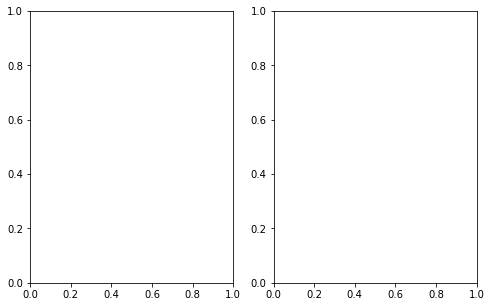

In [33]:
fig, ax = plt.subplots(1,2, figsize=(8,5))
# note that the sentinel data are 16-bit i.e. value range 0-65536, but in this area 
# values are mostly at the lower end, so normalise to 2000 for now.
ax[0].imshow(img_arr)
#ax[1].imshow(img_arr)


In [ ]:
lbl_arr = create_label_array(unique_tiles[200], in_label_file, 'gridcode', label_lyr_idx)

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(8,5))
# note that the sentinel data are 16-bit i.e. value range 0-65536, but in this area 
# values are mostly at the lower end, so normalise to 2000 for now.
ax[0].imshow(img_arr / 2000.)
ax[1].imshow(lbl_arr)

In [34]:
unique_tiles[200]

DLTile(key='256:2:1.0:43:-893:8192',
       resolution=1.0,
       tilesize=256,
       pad=2,
       crs='EPSG:32643',
       bounds=(271390.0, 2097150.0, 271650.0, 2097410.0),
       bounds_crs='EPSG:32643',
       geometry=<shapely.geom...0013B1194FA08>,
       zone=43,
       ti=-893,
       tj=8192,
       geotrans=[
  271390.0,...
  0,
  -1.0
],
       proj4='+proj=utm +z...s=m +no_defs ',
       wkt='PROJCS["WGS ...SG","32643"]]')

#### Exporting the samples to geotiff tiles

Let's create training samples for all our tiles, now. We can do this in multiple processes to run faster.

I'm using a 12-core desktop machine, I'll run 20 jobs in parallel. This seems to work fine on a home broadband connection, i.e. the limiting factor is still how fast the api returns the data, so we can get away with running more jobs than there are cores. 

(For investigation: We could use the Descartes Tasks service to farm this out to *many* machines but it's probably an unnecessary complication at this stage - we'd then have to upload the data from each worker to the DL Storage service, and collate them back in from there at the end. Running on a reasonably decent single machine is fast enough for now).

We use a simple wrapper class to allow us to pass the DLTile object in joblib (it's not otherwise pickleable). 

Note that the functions we are using need to be defined in an external file rather than the notebook in order to work reliably with joblib, otherwise it's pretty hard to sort out the scope of them.

For each DLTile, create a wrapper TileJobConfig object which also contains the output folder, DL product identifier, target date for the mosaicing, the labels dataset, attribute to burn, the index of the labels feature 
class in the dataset, and the bands to extract from the imagery product.

In [98]:
YEAR = 2017
REF_DATE = date(YEAR,6,30)
min_date = date(YEAR,1,1)
max_date = date(YEAR,12,31)                                     
max_cloud_cover = 0.1
_loc="mumbai"
#  17000 was an arbitrary one picked because it showed slum and non-slum
#img_arr_sentinel = create_img_array(unique_tiles[17000], 'sentinel-2:L1C', REF_DATE)
#img_arr = create_img_array(unique_tiles[200], PRODUCT, REF_DATE)

By inspecting the data in the Descartes Labs Viewer, we empirically determine limits for cloud cover fraction to use in the search that will result in a decently-cloud-free mosaic, for each year.

(If the limit is set too low, or to zero, then it might result in too few images being usable to make a mosaic at all).

This is only relevant to Sentinel data, not the airbus stuff.

In [17]:
sentinel_mumbai_year_cf_pairs = [
    (2015, 0.67),
    (2016, 0.67),
    (2017, 0.10),
    (2018, 0.25),
    (2019, 0.15),
    (2020, 0.40)
]
_loc = "mumbai"

In [14]:
airbus_mumbai_year_cf_pairs = [
    (2015, None),
    (2017, None),
    (2018, None),
    (2019, None)
]
_loc = "mumbai"

In [14]:
# sometimes the descartes labs api throws its toys out of the pram; 
# filter the list of jobs in order to rerun if needed
def is_done(jobconfig):
    fn = jobconfig.DLTILE.key.replace(':','#')
    folder = jobconfig.OUTFOLDER
    outimg = os.path.join(folder, 'images', fn) + ".tif"
    return os.path.exists(outimg)


In [15]:
def run_export_for_year(base_run_config, year, cf_fraction, loc):
    base_run_config.MAX_CLOUD_FRACTION = cf_fraction
    ref_date = date(year, 6, 30)
    min_date = date(year, 1, 1)
    max_date = date(year, 12, 31)  
    
    base_run_config.SET_MAX_CLOUD_FRACTION(cf_fraction)
    tile_jobs = base_run_config.create_tile_job_configs(loc_label=loc, year_label=year, 
                                                        ref_date=ref_date, 
                                                        min_date=min_date, max_date=max_date)
    
    _out_folder = base_run_config.images_dir_name(loc, year)
    print(_out_folder)
    print(f"{len(tile_jobs)} jobs")
    
    tile_jobs = [c for c in tile_jobs if not is_done(c)]
    print(f"  of which {len(tile_jobs)} to run (not already done)")
    
    # create_chips_for_tile will make these folders if they don't exist, but when running 
    # in parallel (multiprocessing as opposed to multithreaded) there is a race condition 
    # when another process makes the folder in between the if-folder-does-not-exist and 
    # then-make-folder statements, leading to it often throwing a "directory exists" 
    # exception on the os.makedirs statement.
    # So make them in the caller first.
    imfolder = os.path.join(_out_folder,"images")
    lbfolder = os.path.join(_out_folder,"labels")
    if not os.path.exists(imfolder):
        os.makedirs(imfolder)
    if not os.path.exists(lbfolder):
        os.makedirs(lbfolder)
    
    # run the jobs in parallel
    res = Parallel(n_jobs=N_JOBS)(delayed(create_chips_for_tile)(t) for t in tile_jobs)
    
    # check for any failures
    allok = len([r for r in res if r[1]==None])==0
    if not allok:
        failed_ids = [r[0].DLTILE.key for r in res if r[1]==None]
        print(f"The following tasks failed for job {_out_folder}:\n {failed_ids}")

In [53]:
THIS_RUN_CONFIG = IC_VHR_SAMPLE_CONFIG
N_JOBS = 20

In [56]:
for yr, frac in airbus_mumbai_year_cf_pairs:
    run_export_for_year(THIS_RUN_CONFIG, yr, frac, _loc)

C:/Users/harry/Documents/Data/airbus_1m_2pad_256_mumbai_2015
5976 jobs
0 not already done - to run
C:/Users/harry/Documents/Data/airbus_1m_2pad_256_mumbai_2017
5976 jobs
0 not already done - to run
C:/Users/harry/Documents/Data/airbus_1m_2pad_256_mumbai_2018
5976 jobs
45 not already done - to run
The following tasks failed for job C:/Users/harry/Documents/Data/airbus_1m_2pad_256_mumbai_2018:
 ['252:2:1.0:43:-927:8438', '252:2:1.0:43:-927:8439', '252:2:1.0:43:-927:8440', '252:2:1.0:43:-926:8438', '252:2:1.0:43:-926:8439', '252:2:1.0:43:-926:8440', '252:2:1.0:43:-925:8438', '252:2:1.0:43:-925:8439', '252:2:1.0:43:-925:8440', '252:2:1.0:43:-929:8433', '252:2:1.0:43:-929:8434', '252:2:1.0:43:-928:8433', '252:2:1.0:43:-928:8434', '252:2:1.0:43:-927:8433', '252:2:1.0:43:-927:8434', '252:2:1.0:43:-927:8436', '252:2:1.0:43:-927:8437', '252:2:1.0:43:-926:8435', '252:2:1.0:43:-926:8436', '252:2:1.0:43:-926:8437', '252:2:1.0:43:-925:8435', '252:2:1.0:43:-925:8436', '252:2:1.0:43:-925:8437', '252:

In [19]:
THIS_RUN_CONFIG = IC_LR_SAMPLE_CONFIG # IC_LR_SAMPLE_CONFIG
N_JOBS = 30

In [121]:
t = c[0]
t

In [123]:
t

In [24]:
for yr, frac in sentinel_mumbai_year_cf_pairs:
    run_export_for_year(THIS_RUN_CONFIG, yr, frac, _loc)


C:/Users/harry/Documents/Data/sentinel-cf0p67_10m_2pad_64_mumbai_2015
1335 jobs
  of which 0 to run (not already done)
C:/Users/harry/Documents/Data/sentinel-cf0p67_10m_2pad_64_mumbai_2016
1335 jobs
  of which 0 to run (not already done)
C:/Users/harry/Documents/Data/sentinel-cf0p1_10m_2pad_64_mumbai_2017
1335 jobs
  of which 0 to run (not already done)
C:/Users/harry/Documents/Data/sentinel-cf0p25_10m_2pad_64_mumbai_2018
1335 jobs
  of which 0 to run (not already done)
C:/Users/harry/Documents/Data/sentinel-cf0p15_10m_2pad_64_mumbai_2019
1335 jobs
  of which 1 to run (not already done)
C:/Users/harry/Documents/Data/sentinel-cf0p4_10m_2pad_64_mumbai_2020
1335 jobs
  of which 0 to run (not already done)


## Use multiprocessing to efficiently grab all tiles 

For running locally, reduce  process priority so we can run at least as many processes as we have cores without compromising usability of the machine while it runs.

Set the priority of the parent (this) process before creating children, and it will inherit, so we don't need to do this in the worker function.

This syntax is for windows, on linux we need to use a numeric value I think

In [21]:
import psutil, os
p = psutil.Process(os.getpid())
print("Priority before: " + str(p.nice()))
p.nice(psutil.IDLE_PRIORITY_CLASS)
print("Priority after: " + str(p.nice()))

Priority before: Priority.NORMAL_PRIORITY_CLASS
Priority after: Priority.IDLE_PRIORITY_CLASS


In [22]:
from joblib import Parallel, delayed
import multiprocessing

I am running on a laptop with 12 virtual (hyperthreading) cores (i.e. 6 physical cores), and a 70MB connection.

The number of jobs we can run depends on the responsiveness of the DL API in returning the requested mosaic i.e. how much time we are waiting around before having to do the local work of saving the data.

For the VHR data the response is quite fast. I found that 20 jobs was a reasonable compromise for getting CPU usage to ~100% without being totally pegged (and connection speed is barely touched). Machine remains responsive whilst running, and Mumbai VHR tiles (c.5795 images) are created in c.25 minutes.

For the Sentinel data the response is much slower (even though the returned data size is less). We can run more processes: say 30.

In [33]:
N_JOBS = 20
# 20 for VHR; 30 for sentinel, on a 12-virtual-core laptop

We created a function create_chips_for_tile that downloads the image and rasterises the labels for a single TileJobConfig. Test it for one:

In [103]:
create_chips_for_tile(inputs[0])

(None, None)

Run the exports!

In [124]:
res = Parallel(n_jobs=N_JOBS)(delayed(create_chips_for_tile)(t) for t in inputs)

Check for errors.

The create image function returns a 3-tuple (TileJobConfig, Path_To_Image, Path_To_Label).

The second and third items are None if there is no data available for the footprint of the tile, or if another error occurred.
E.g. pleiades data is only avaiable in some cities; Sentinel sometimes fails to mosaic at all; there may be no data matching the cloud specification.

Did it all go through without errors?

In [112]:
allok = len([r for r in res if r[1]==None])==0
allok

False

If not, how many tasks gave errors?

In [113]:
len([r for r in res if r[1]==None])

1

Make a note of the DLTile IDs for which errors occurred.

In [114]:
failed_ids = [r[0].DLTILE.key for r in res if r[1]==None]
_out_folder, failed_ids

('C:/Users/harry/Documents/Data/sentinel-cf0p25_10m_2pad_64_mumbai_2018',
 ['64:2:10.0:43:-351:3304'])